In [2]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.cluster import KMeans
import sklearn.metrics as metrics
import plotly.express as px

In [3]:
# Access data from csv that Kate shared
df = pd.read_csv('WMA_fractions_v2.csv', skiprows=1)

In [4]:
# Divide into 5 depth levels
d_min = df['Depth_[m]'].min()
d_max = df['Depth_[m]'].max()
depth_levels = [d_min + i * (d_max - d_min) / 5 for i in range(6)]

In [5]:
depth_levels

[5.0, 203.0, 401.0, 599.0, 797.0, 995.0]

# Level 0 - Surface

In [6]:
df_l0 = df.copy()
df_l0 = df[df_l0['Depth_[m]'] <= depth_levels[1]]
df_l0_STO = df_l0[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_l0_STO = df_l0_STO.dropna()

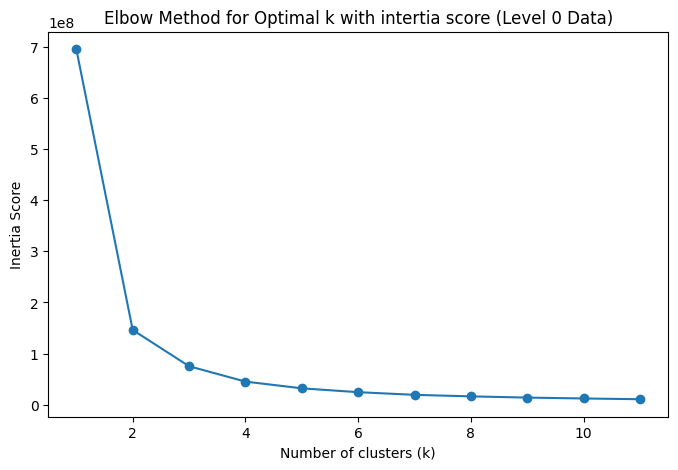

In [7]:
# Elbow method for mid depth data
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=22)
    kmeans.fit(df_l0_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

# Plot elbow method
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Level 0 Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [8]:
# Do kmeans clustering on level 0 depth data with 2 clusters
kmeans_l0 = KMeans(n_clusters=2, random_state=22)
X = df_l0_STO.iloc[:,[0,1,2]].values
y_kmeans = kmeans_l0.fit_predict(X)
df_l0_STO['kmeans_classification'] = y_kmeans

# Plot in geographic map
# Compute data centroid (mean location)
center_lat = df_l0_STO['Latitude_[deg_N]'].mean()
center_lon = df_l0_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_l0_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) on Data at depths 5-203m'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 79.79303988451316 Center lon: -90.95522706394428


# Level 1

In [32]:
df_l1 = df.copy()
df_l1 = df_l1[(df_l1['Depth_[m]'] > depth_levels[1]) & (df_l1['Depth_[m]'] <= depth_levels[2])]
df_l1_STO = df_l1[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_l1_STO = df_l1_STO.dropna()

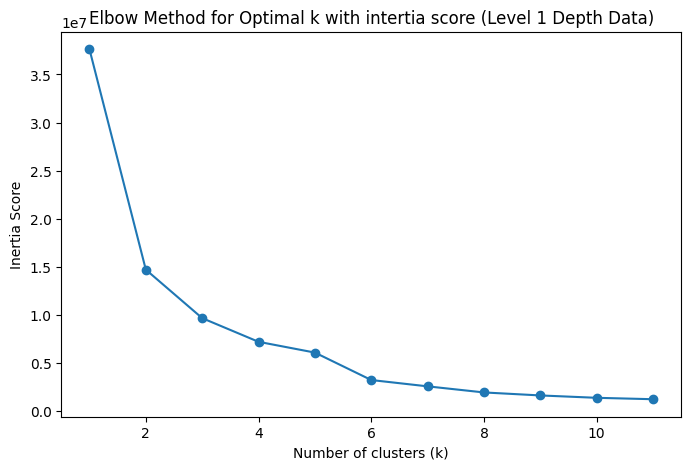

In [37]:
# Elbow method for level 1 depth data
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=22)
    kmeans.fit(df_l1_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

# Plot elbow method
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Level 1 Depth Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [35]:
# Do kmeans clustering on level 1 depth data with 5 clusters
kmeans = KMeans(n_clusters=5, random_state=22)
X = df_l1_STO.iloc[:,[0,1,2]].values
y_kmeans = kmeans.fit_predict(X)
df_l1_STO['kmeans_classification'] = y_kmeans

# Plot in geographic map
# Compute data centroid (mean location)
center_lat = df_l1_STO['Latitude_[deg_N]'].mean()
center_lon = df_l1_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_l1_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) on Data at depths 203-401m'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 80.29290342911175 Center lon: -92.60042656422188


# Level 2

In [36]:
df_l2 = df.copy()
df_l2 = df_l2[(df_l2['Depth_[m]'] > depth_levels[2]) & (df_l2['Depth_[m]'] <= depth_levels[3])]
df_l2_STO = df_l2[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_l2_STO = df_l2_STO.dropna()

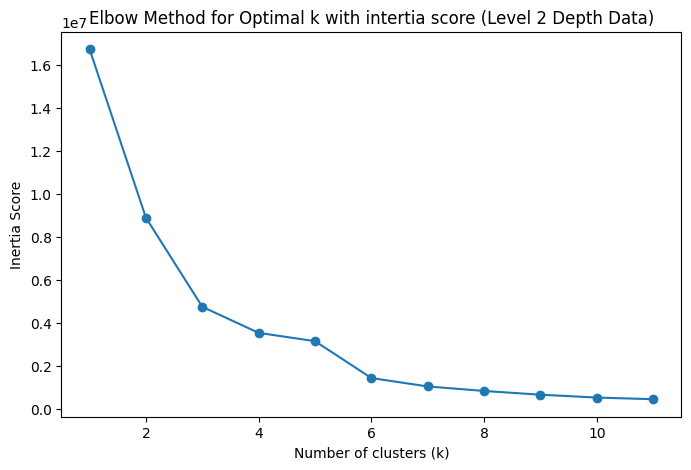

In [38]:
# Elbow method for level 2 depth data
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=22)
    kmeans.fit(df_l2_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

# Plot elbow method
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Level 2 Depth Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [52]:
# Do kmeans clustering on level 1 depth data with 5 clusters
kmeans = KMeans(n_clusters=5, random_state=22)
X = df_l2_STO.iloc[:,[0,1,2]].values
y_kmeans = kmeans.fit_predict(X)
df_l2_STO['kmeans_classification'] = y_kmeans

# Plot in geographic map
# Compute data centroid (mean location)
center_lat = df_l2_STO['Latitude_[deg_N]'].mean()
center_lon = df_l2_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_l2_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) on Data at depths 401-599m'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 80.41100497952898 Center lon: -92.0835238933408


# Level 3

In [40]:
df_l3 = df.copy()
df_l3 = df_l3[(df_l3['Depth_[m]'] > depth_levels[3]) & (df_l3['Depth_[m]'] <= depth_levels[4])]
df_l3_STO = df_l3[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_l3_STO = df_l3_STO.dropna()

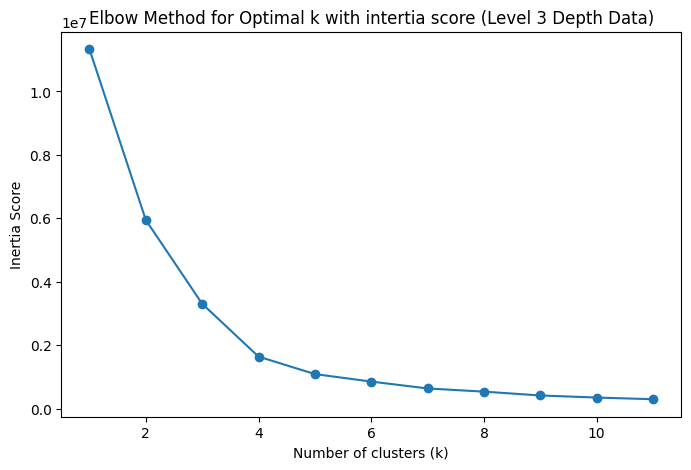

In [41]:
# Elbow method for level 3 depth data
n_clusters = range(1, 12)
inertias = []

for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=22)
    kmeans.fit(df_l3_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

# Plot elbow method
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Level 3 Depth Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [53]:
# Do kmeans clustering on level 3 depth data with 4 clusters
kmeans = KMeans(n_clusters=4, random_state=22)
X = df_l3_STO.iloc[:,[0,1,2]].values
y_kmeans = kmeans.fit_predict(X)
df_l3_STO['kmeans_classification'] = y_kmeans
# Plot in geographic map
# Compute data centroid (mean location)
center_lat = df_l3_STO['Latitude_[deg_N]'].mean()
center_lon = df_l3_STO['Longitude_[deg_E]'].mean()

print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_l3_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) on Data at depths 599-797m'
)
fig.update_geos(    
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),
    showcoastlines=True,
    showcountries=True
)
fig.update_layout(height=800, width=800)
fig.show()

Center lat: 80.45443416741139 Center lon: -91.75458437367419


# Level 4

In [43]:
df_l4 = df.copy()
df_l4 = df_l4[(df_l4['Depth_[m]'] > depth_levels[4]) & (df_l4['Depth_[m]'] <= depth_levels[5])]
df_l4_STO = df_l4[['Latitude_[deg_N]', 'Longitude_[deg_E]','Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']]
df_l4_STO = df_l4_STO.dropna()

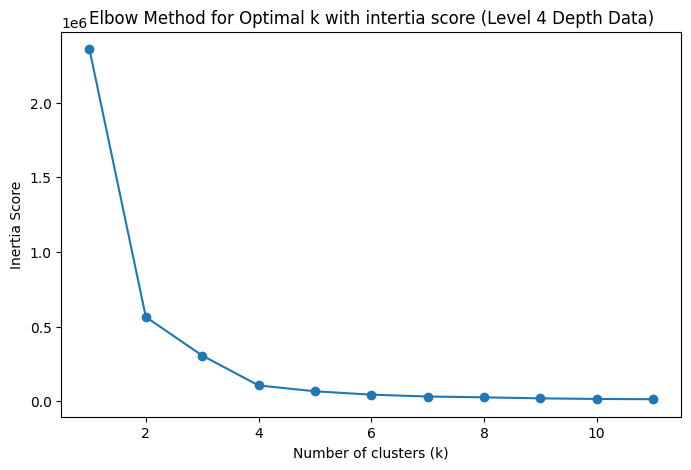

In [44]:
# Elbow method for level 4 depth data
n_clusters = range(1, 12)
inertias = []
for n in n_clusters:
    kmeans = KMeans(n_clusters=n, random_state=22)
    kmeans.fit(df_l4_STO[['Conservative_Temperature_[deg_C]', 'Absolute_Salinity_[PSU]', 'Dissolved_Oxygen_[micro_mol_per_kg]']])
    inertia = kmeans.inertia_
    inertias.append(inertia)

# Plot elbow method
plt.figure(figsize=(8, 5))
plt.title('Elbow Method for Optimal k with intertia score (Level 4 Depth Data)')
plt.xlabel('Number of clusters (k)')
plt.ylabel('Inertia Score')
plt.plot(n_clusters, inertias, marker='o')

In [54]:
# Do kmeans clustering on level 4 depth data with 2 clusters
kmeans = KMeans(n_clusters=2, random_state=22)
X = df_l4_STO.iloc[:,[0,1,2]].values
y_kmeans = kmeans.fit_predict(X)
df_l4_STO['kmeans_classification'] = y_kmeans

# Plot in geographic map    
# Compute data centroid (mean location)
center_lat = df_l4_STO['Latitude_[deg_N]'].mean()
center_lon = df_l4_STO['Longitude_[deg_E]'].mean()
print("Center lat:", center_lat, "Center lon:", center_lon)

fig = px.scatter_geo(
    df_l4_STO,
    lat='Latitude_[deg_N]',
    lon='Longitude_[deg_E]',
    color='kmeans_classification',
    title='Water Mass Classification (KMeans) on Data at depths 797-995m'
)

fig.update_geos(
    projection_type="orthographic",
    projection_rotation=dict(lat=center_lat, lon=center_lon),
    showcoastlines=True,
    showcountries=True
)

fig.update_layout(height=800, width=800)
fig.show()

Center lat: 73.42526853997683 Center lon: -27.726904692931633
